# MB Product

<div>
    <img style='width: 220px;height: 100px;float: left;' src="../../Supplementary_data/EODC-Logo-Final.png" height='100px' width='220px'/>
    <img style='width: 200px;height: 100px;float: left;' src="../../Supplementary_data/BMNT_DE_Logo_dreizeilig_srgb.svg" height='100px' width='200px'/> 
    <img style='width: 200px;height: 100px;float: left;' src="../../Supplementary_data/bmlv.svg" height='100px' width='200px'/>
    <img style='width: 200px;height: 100px;float: left;' src="../../Supplementary_data/LOGO_TUW_GEO.png" height='100px' width='200px'/>
    <img style='width: 100px;height: 100px;float: left;' src="../../Supplementary_data/Boku-wien.svg" height='100px' width='100px'/>
    <img style='width: 150px;height: 100px;float: right;' src="../../Supplementary_data/ADC_Logo_final_transparent.png" height='100px' width='150px'/>
</div>

This notebook shows the MB product created by BOKU. This product contains the atmospherically-corrected Sentinel-2A and 2B data, temporally aggregated over monthly periods. If two or more valid pixels are found in the monthly compositing period, only the most recent pixel is taken. The product is resampled to the Equi7 Grid, covers an area of 100 km x 100 km with a pixel sampling of 10 m.

The product name in the ACube is `MB_Sentinel_2`. It is composed of ten measurements `B02`, `B03`, `B04`, `B05`, `B06`, `B07`, `B08`, `B8A`, `B11` and `B12`.

Relevant links:
* https://acube.eodc.eu/xwiki/bin/view/2.%20Terminology/3.3.%20Datasets/3.4.2.%20Sentinel-2%20data/3.4.2.3.%20Products/
* https://acube.eodc.eu/xwiki/bin/view/2.%20Terminology/3.3.%20Datasets/3.4.2.%20Sentinel-2%20data/

## Exploring the product

The code below initialises the datacube and lists some metadata of the product, measurements and datasets. We can see that this product has two measurements and a spatial resolution of 10 m. We also list the metadata fields that are available.

In [1]:
import datacube
import xarray
from pprint import pprint
%matplotlib inline
dc = datacube.Datacube(app='sample_mb', env='acube')
product = 'MB_Sentinel_2'

In [2]:
prodlist=dc.list_products().dropna(axis=1)
prodlist[prodlist['name'] == product]

,name,description,product_type,format,instrument,platform,crs,resolution,spatial_dimensions
id,,,,,,,,,
28,MB_Sentinel_2,Monthly composite atmospherically corrected Se...,BOKU_MB_S2,GeoTIFF,MSI,Sentinel-2,"PROJCS[""unnamed"",GEOGCS[""WGS 84"",DATUM[""WGS_19...","(-10, 10)","(y, x)"


In [3]:
measlist = dc.list_measurements()
measlist.loc[measlist.index.get_level_values(0) == product]

name   dtype     units  nodata  \
product       measurement                                  
MB_Sentinel_2 B02          B02  uint16  fraction       0   
              B03          B03  uint16  fraction       0   
              B04          B04  uint16  fraction       0   
              B05          B05  uint16  fraction       0   
              B06          B06  uint16  fraction       0   
              B07          B07  uint16  fraction       0   
              B08          B08  uint16  fraction       0   
              B8A          B8A  uint16  fraction       0   
              B11          B11  uint16  fraction       0   
              B12          B12  uint16  fraction       0   

                                                       aliases  
product       measurement                                       
MB_Sentinel_2 B02             [band_2, band_02, Band2, Band_2]  
              B03             [band_3, band_03, Band3, Band_3]  
              B04             [band_4, band_04, Band4, Band_4]  
              B05             [band_5, band_05, Band5, Band_5]  
              B06             [band_6, band_06, Band6, Band_6]  
              B07             [band_7, band_07, Band7, Band_7]  
              B08             [band_8, band_08, Band8, Band_8]  
              B8A          [band_8a, band_8A, Band8A, Band_8A]  
              B11                   [band_11, Band11, Band_11]  
              B12                   [band_12, Band12, Band_12]

In [4]:
query = {
    'lat': (48.15, 48.35),
    'lon': (16.3, 16.5),
    'time': ('2019-06-06', '2019-07-06')
}

In [5]:
for dataset in dc.find_datasets_lazy(product=product, **query):
    print(100*'*')
    print('METADATA FIELDS: ', sorted(list(dataset.metadata_doc.keys())))
    print(100*'*')
    print('METADATA')
    pprint(dataset.metadata_doc)
    print(100*'*')

****************************************************************************************************
METADATA FIELDS:  ['equi7_system', 'equi7_tile', 'extent', 'format', 'grid_spatial', 'id', 'image', 'instrument', 'lineage', 'name', 'platform', 'product_type']
****************************************************************************************************
METADATA
{'equi7_system': 'EU010M',
 'equi7_tile': 'E052N016T1',
 'extent': {'center_dt': '2019-06-01T00:00:00',
            'coord': {'ll': {'lat': 47.97836637131796,
                             'lon': 15.455732336236064},
                      'lr': {'lat': 48.0747977797218, 'lon': 16.78723851350588},
                      'ul': {'lat': 48.87019287824474,
                             'lon': 15.300385421628878},
                      'ur': {'lat': 48.96874953569572,
                             'lon': 16.65563642003795}},
            'from_dt': '2019-06-01T00:00:00',
            'to_dt': '2019-06-30T00:00:00'},
 'format': {'nam

## Querying and displaying the data

In [6]:
data = dc.load(product=product, 
               output_crs='EPSG:32633', 
               resolution=(-10,10),
                **query)
data

<xarray.Dataset>
Dimensions:      (time: 2, x: 1526, y: 2250)
Coordinates:
  * time         (time) datetime64[ns] 2019-06-15T12:00:00 2019-07-16
  * y            (y) float64 5.356e+06 5.356e+06 ... 5.334e+06 5.334e+06
  * x            (x) float64 5.963e+05 5.963e+05 ... 6.116e+05 6.116e+05
    spatial_ref  int32 32633
Data variables:
    B02          (time, y, x) uint16 233 123 271 317 130 287 ... 0 0 737 735 968
    B03          (time, y, x) uint16 419 247 495 538 318 ... 0 0 907 945 1113
    B04          (time, y, x) uint16 194 146 214 252 175 ... 0 0 964 1044 1157
    B05          (time, y, x) uint16 733 618 803 681 681 ... 0 0 1206 1206 1542
    B06          (time, y, x) uint16 2845 2792 2992 2882 ... 0 1537 1537 1798
    B07          (time, y, x) uint16 3676 3710 3836 3620 ... 0 1705 1705 1980
    B08          (time, y, x) uint16 3408 3213 3863 4499 ... 0 1827 2104 2209
    B8A          (time, y, x) uint16 3955 4038 4047 3938 ... 0 1766 1766 2141
    B11          (time, y, x) uint16 1616 1586 1657 1471 ... 0 2024 2024 2308
    B12          (time, y, x) uint16 702 681 699 616 616 ... 0 0 1672 1672 1865
Attributes:
    crs:           EPSG:32633
    grid_mapping:  spatial_ref

Using this product it is possible to create many different combination plots. Below we define a function that plots the given bands and applies a saturation mask.

Source: https://giscrack.com/list-of-band-combinations-in-sentinel-2a/

* Natural Colors: B04 B03 B02
* False color Infrared: B08 B04 B03
* False color Urban: B12 B011 B04
* Agriculture: B11 B08 B02
* Atmospheric penetration: B12 B11 B8A
* Healthy vegetation: B08 B11 B02
* Land/Water: B08 B11 B04
* Natural Colors with Atmospheric Removal: B12 B08 B03
* Shortwave Infrared: B12 B08 B04
* Vegetation Analysis: B11 B08 B04
* Geology: B12 B11 B02

In [7]:
def plot_bands(data, band1, band2, band3, fake_saturation=None):
    new_data = data[[band1, band2, band3]]
    data_plot = new_data.to_array(dim='color')
    if fake_saturation:
        data_plot = data_plot.transpose(*(data_plot.dims[1:]+data_plot.dims[:1]))
        data_plot = data_plot.where((data_plot <= fake_saturation).all(dim='color'))
        data_plot /= fake_saturation
    data_plot.plot.imshow(
        x='x', 
        y='y',
        col='time',
        size=10,
    )

### Natural Colors

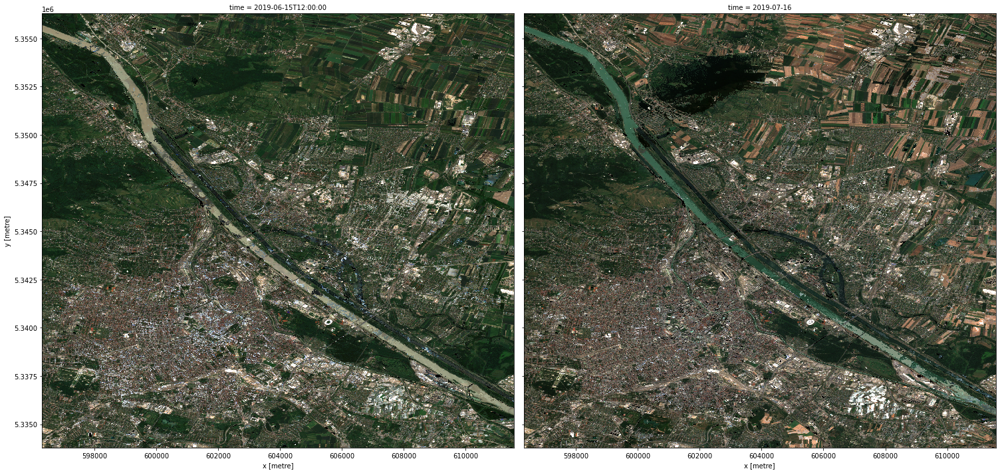

In [8]:
plot_bands(data, 'B04', 'B03', 'B02', fake_saturation=3000)

### False color Infrared

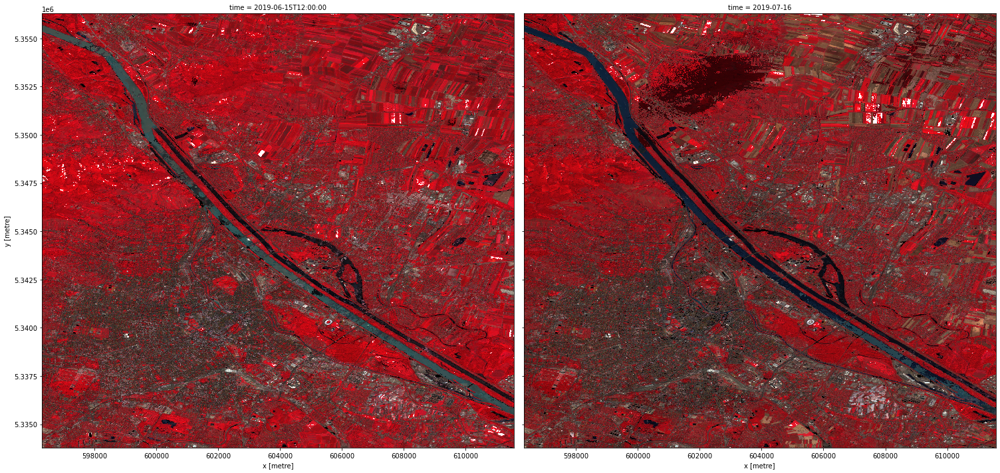

In [9]:
plot_bands(data, 'B08', 'B04', 'B03', fake_saturation=5700)

### False Color Urban

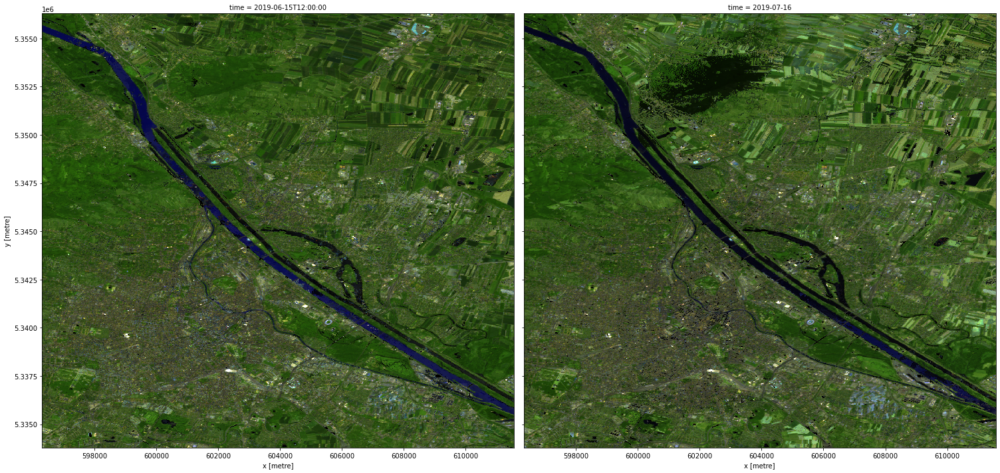

In [10]:
plot_bands(data, 'B12', 'B11', 'B04', fake_saturation=6000)

### Agriculture

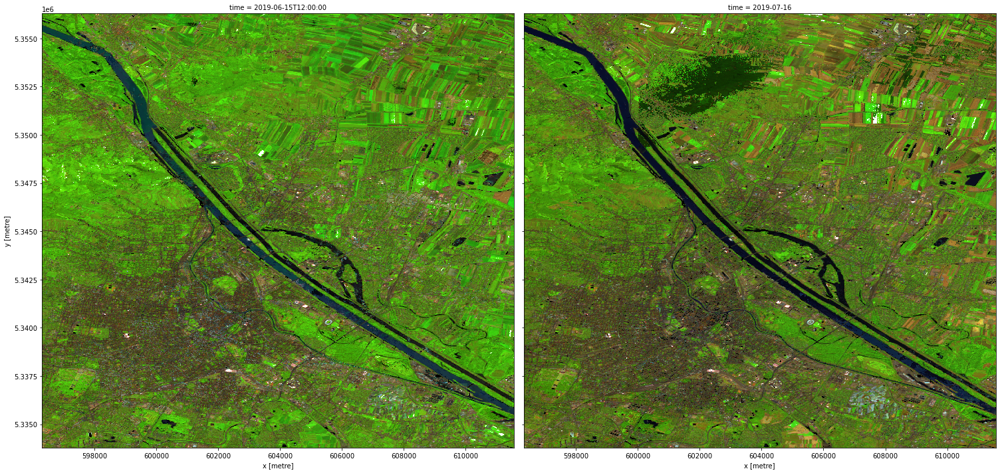

In [11]:
plot_bands(data, 'B11', 'B08', 'B02', fake_saturation=6000)

### Atmospheric penetration

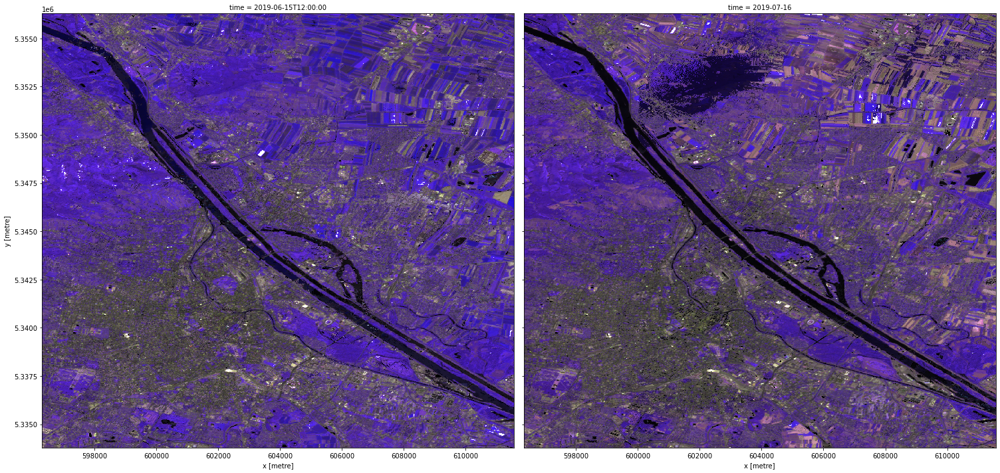

In [12]:
plot_bands(data, 'B11', 'B12', 'B8A', fake_saturation=6000)

### Healthy Vegetation

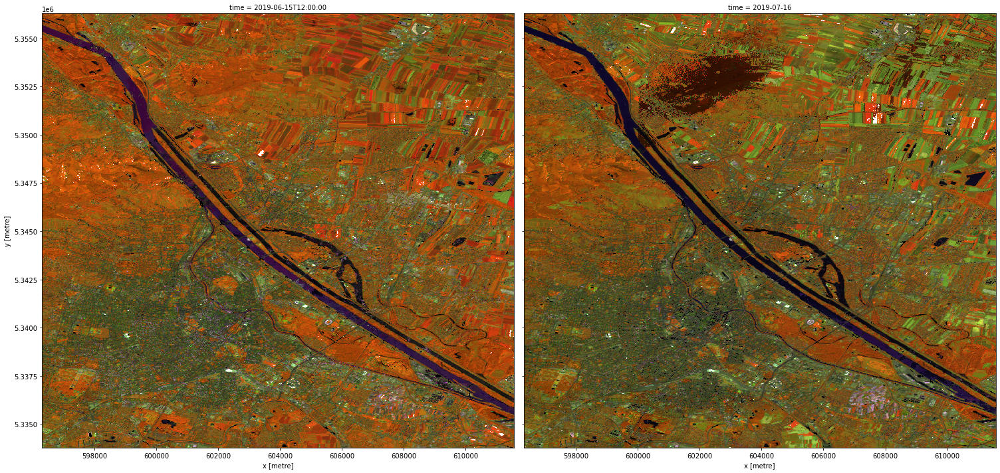

In [13]:
plot_bands(data, 'B08', 'B11', 'B02', fake_saturation=6000)

### Land/Water

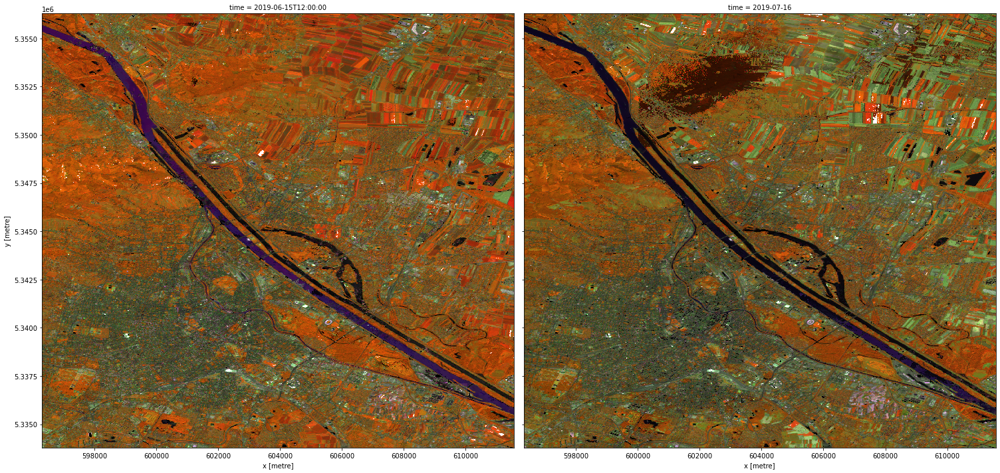

In [14]:
plot_bands(data, 'B08', 'B11', 'B04', fake_saturation=6000)

### Natural Colors with Atmospheric Removal

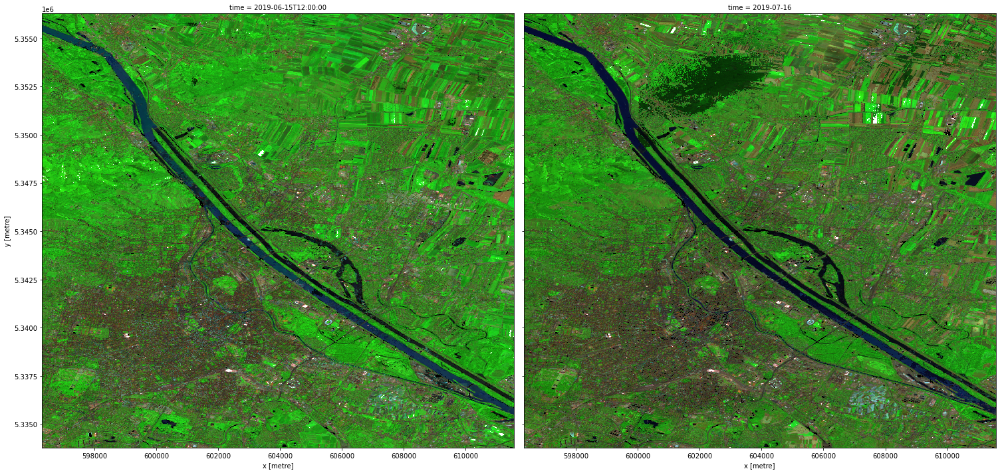

In [15]:
plot_bands(data, 'B12', 'B08', 'B03', fake_saturation=6000)

### Shortwave Infrared

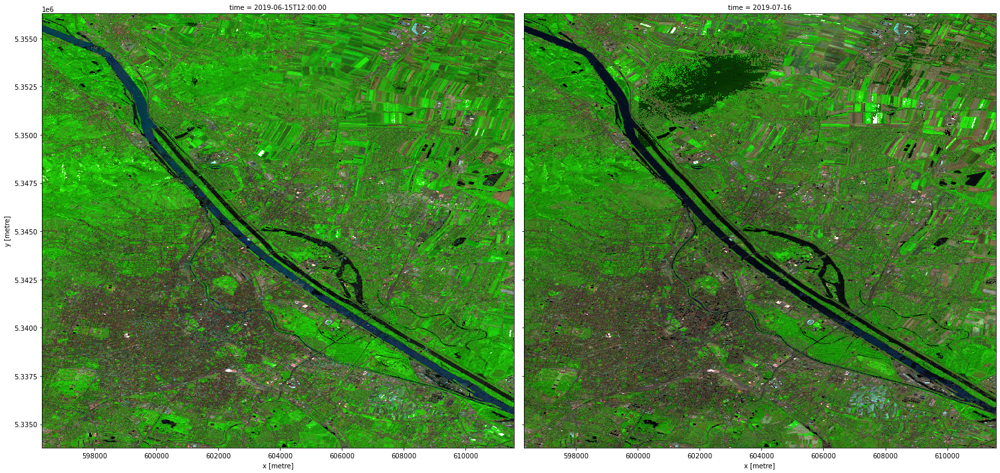

In [16]:
plot_bands(data, 'B12', 'B08', 'B04', fake_saturation=6000)

### Vegetation Analysis

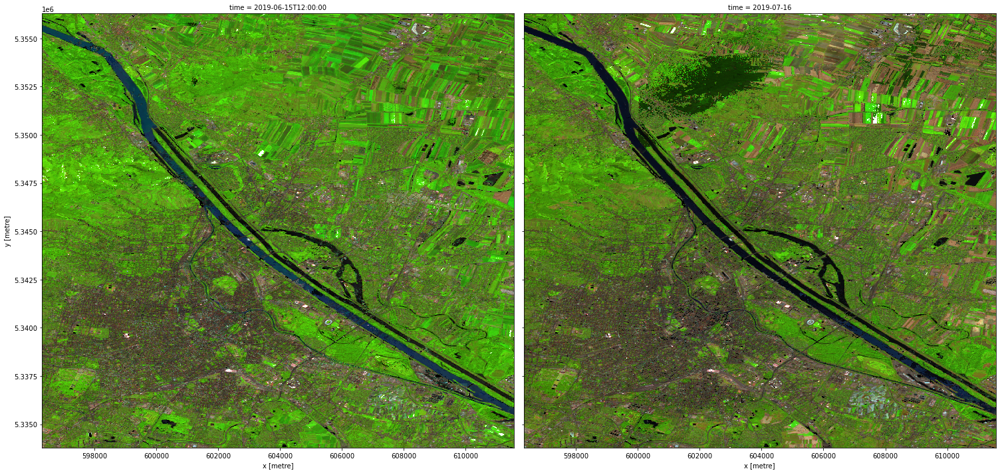

In [17]:
plot_bands(data, 'B11', 'B08', 'B04', fake_saturation=6000)

### Geology 

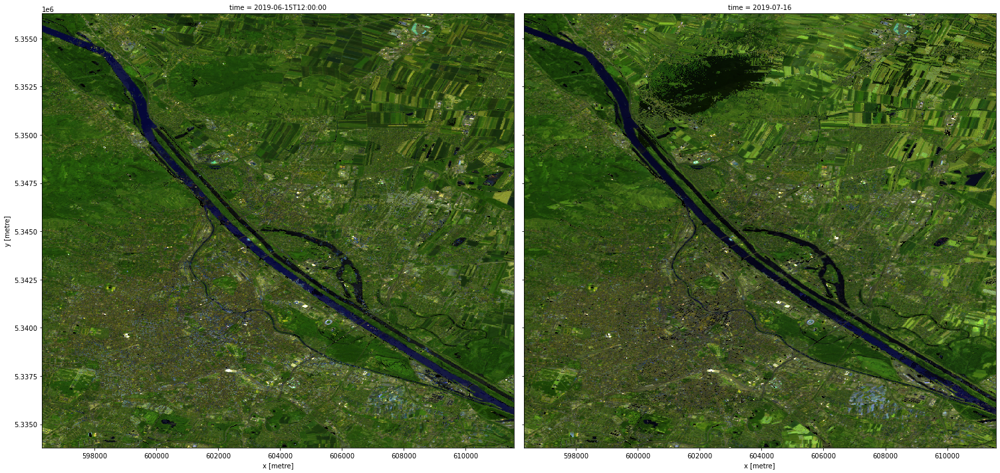

In [18]:
plot_bands(data, 'B12', 'B11', 'B02', fake_saturation=6000)